# hj_reachability quickstart

Notebook dependencies:
- System: python3, ffmpeg (for rendering animations)
- Python: jupyter, jax, numpy, matplotlib, plotly, tqdm, hj_reachability

Example setup for a Ubuntu system (Mac users, maybe `brew` instead of `sudo apt`; Windows users, learn to love [WSL](https://docs.microsoft.com/en-us/windows/wsl/install-win10)):
```
sudo apt install ffmpeg
/usr/bin/python3 -m pip install --upgrade pip
pip install --upgrade jupyter jax[cpu] numpy matplotlib plotly tqdm hj-reachability
jupyter notebook  # from the directory of this notebook
```
Alternatively, view this notebook on [Google Colab](https://colab.research.google.com/github/StanfordASL/hj_reachability/blob/main/examples/quickstart.ipynb) and run a cell containing this command:
```
!pip install --upgrade hj-reachability
```

In [1]:
import jax
import jax.numpy as jnp
import numpy as np

from IPython.display import HTML
import matplotlib.animation as anim
import matplotlib.pyplot as plt
import plotly.graph_objects as go

import hj_reachability as hj

## Example system: `Air3d`

In [2]:
dynamics = hj.systems.Air3d()
grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(hj.sets.Box(np.array([-6., -10., 0.]),
                                                                           np.array([20., 10., 2 * np.pi])),
                                                               (51, 40, 50),
                                                               periodic_dims=2)
values = jnp.linalg.norm(grid.states[..., :2], axis=-1) - 5

solver_settings = hj.SolverSettings.with_accuracy("very_high",
                                                  hamiltonian_postprocessor=hj.solver.backwards_reachable_tube)

### `hj.step`: propagate the HJ PDE from `(time, values)` to `target_time`.

In [3]:
time = 0.
target_time = -2.8
target_values = hj.step(solver_settings, dynamics, grid, time, values, target_time)

100%|##########|  2.8000/2.8 [00:07<00:00,  2.80s/sim_s]


(51, 40, 50)


<Figure size 640x480 with 0 Axes>

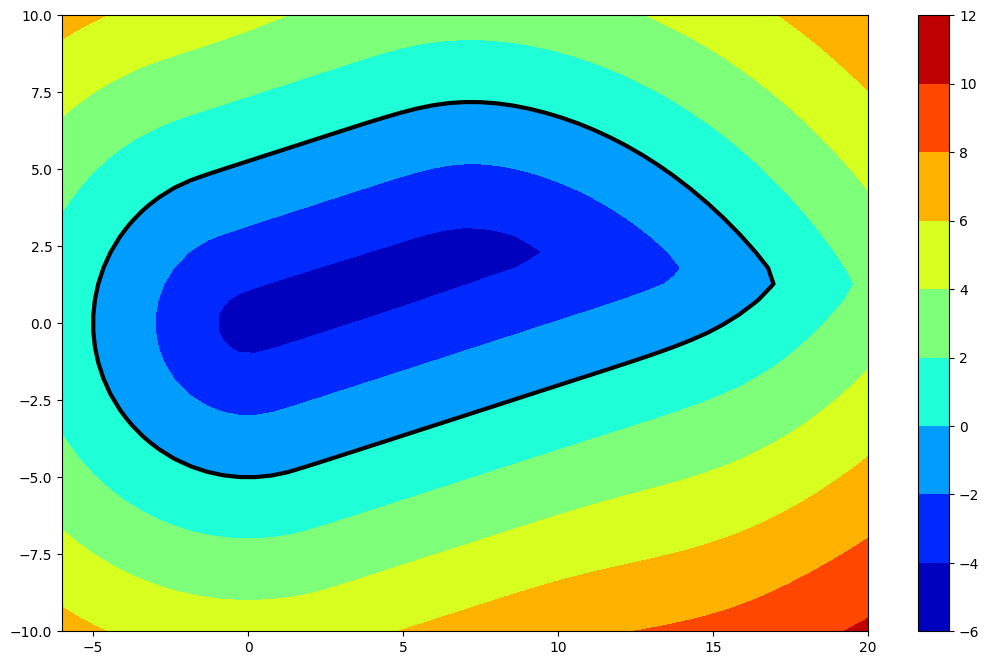

In [4]:
print(target_values.shape)

plt.jet()
plt.figure(figsize=(13, 8))
plt.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1], target_values[:, :, 30].T)
plt.colorbar()
plt.contour(grid.coordinate_vectors[0],
            grid.coordinate_vectors[1],
            target_values[:, :, 30].T,
            levels=0,
            colors="black",
            linewidths=3)

In [5]:
go.Figure(data=go.Isosurface(x=grid.states[..., 0].ravel(),
                             y=grid.states[..., 1].ravel(),
                             z=grid.states[..., 2].ravel(),
                             value=target_values.ravel(),
                             colorscale="jet",
                             isomin=0,
                             surface_count=1,
                             isomax=0))

### `hj.solve`: solve for `all_values` at a range of `times` (basically just iterating `hj.step`).

In [6]:
times = np.linspace(0, -2.8, 57)
initial_values = values
all_values = hj.solve(solver_settings, dynamics, grid, times, initial_values)
print(all_values.shape)

100%|##########|  2.8000/2.8 [00:08<00:00,  2.89s/sim_s]

(57, 51, 40, 50)


In [7]:
vmin, vmax = all_values.min(), all_values.max()
levels = np.linspace(round(vmin), round(vmax), round(vmax) - round(vmin) + 1)
fig = plt.figure(figsize=(13, 8))


def render_frame(i, colorbar=False):
    plt.contourf(grid.coordinate_vectors[0],
                 grid.coordinate_vectors[1],
                 all_values[i, :, :, 30].T,
                 vmin=vmin,
                 vmax=vmax,
                 levels=levels)
    if colorbar:
        plt.colorbar()
    plt.contour(grid.coordinate_vectors[0],
                grid.coordinate_vectors[1],
                target_values[:, :, 30].T, # slicing at one layer
                levels=0,
                colors="black",
                linewidths=3)


render_frame(0, True)
animation = HTML(anim.FuncAnimation(fig, render_frame, all_values.shape[0], interval=50).to_html5_video())
plt.close(); animation

## Defining your own dynamics: `AccelerationCurvatureCar`

In [8]:
class AccelerationCurvatureCar(hj.ControlAndDisturbanceAffineDynamics):

    def __init__(self,
                 max_acceleration=1.,
                 max_curvature=1.,
                 max_position_disturbance=0.25,
                 control_mode="min",
                 disturbance_mode="max",
                 control_space=None,
                 disturbance_space=None):
        if control_space is None:
            control_space = hj.sets.Box(jnp.array([-max_acceleration, -max_curvature]),
                                        jnp.array([max_acceleration, max_curvature]))
        if disturbance_space is None:
            disturbance_space = hj.sets.Ball(jnp.zeros(2), max_position_disturbance)
        super().__init__(control_mode, disturbance_mode, control_space, disturbance_space)

    def open_loop_dynamics(self, state, time):
        _, _, v, q = state
        return jnp.array([v * jnp.cos(q), v * jnp.sin(q), 0., 0.])

    def control_jacobian(self, state, time):
        v = state[2]
        return jnp.array([
            [0., 0.],
            [0., 0.],
            [1., 0.],
            [0., v],
        ])

    def disturbance_jacobian(self, state, time):
        return jnp.array([
            [1., 0.],
            [0., 1.],
            [0., 0.],
            [0., 0.],
        ])

In [9]:
dynamics = AccelerationCurvatureCar()
grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(hj.sets.Box(lo=np.array([-5., -5., -1., -np.pi]),
                                                                           hi=np.array([5., 5., 1., np.pi])),
                                                               (40, 40, 50, 50),
                                                               periodic_dims=3)



print(grid.states)
values = jnp.linalg.norm(grid.states[..., :2], axis=-1) - 1

solver_settings = hj.SolverSettings.with_accuracy("low")

[[[[[-5.         -5.         -1.         -3.1415927 ]
    [-5.         -5.         -1.         -3.015929  ]
    [-5.         -5.         -1.         -2.8902652 ]
    ...
    [-5.         -5.         -1.          2.7646017 ]
    [-5.         -5.         -1.          2.8902655 ]
    [-5.         -5.         -1.          3.015929  ]]

   [[-5.         -5.         -0.9591837  -3.1415927 ]
    [-5.         -5.         -0.9591837  -3.015929  ]
    [-5.         -5.         -0.9591837  -2.8902652 ]
    ...
    [-5.         -5.         -0.9591837   2.7646017 ]
    [-5.         -5.         -0.9591837   2.8902655 ]
    [-5.         -5.         -0.9591837   3.015929  ]]

   [[-5.         -5.         -0.9183674  -3.1415927 ]
    [-5.         -5.         -0.9183674  -3.015929  ]
    [-5.         -5.         -0.9183674  -2.8902652 ]
    ...
    [-5.         -5.         -0.9183674   2.7646017 ]
    [-5.         -5.         -0.9183674   2.8902655 ]
    [-5.         -5.         -0.9183674   3.015929  ]]

In [10]:
time = 0.
target_time = -2.0
target_values = hj.step(solver_settings, dynamics, grid, time, values, target_time)
print(target_values.shape)

100%|##########|  2.0000/2.0 [01:02<00:00, 31.30s/sim_s]

(40, 40, 50, 50)


In [11]:
print(target_values.shape)

go.Figure(data=go.Isosurface(x=grid.states[:, :, -1, :, 0].ravel(),
                             y=grid.states[:, :, -1, :, 1].ravel(),
                             z=grid.states[:, :, -1, :, 3].ravel(),
                             value=target_values[:, :, -1, :].ravel(),
                             colorscale='jet',
                             isomin=0,
                             surface_count=1,
                             isomax=0))

(40, 40, 50, 50)


## Defining your own dynamics: `Duffing`

In [25]:
class Duffing(hj.ControlAndDisturbanceAffineDynamics):

    def __init__(self, alpha=1., beta=1., delta=0.,
                 max_u=1.,
                 max_d=0.5,
                 control_mode="min",
                 disturbance_mode="max",
                 control_space=None,
                 disturbance_space=None): #pointless
        
        # review alpha, beta, and delta
        if control_space is None:
            control_space = hj.sets.Box(jnp.array([-max_u]),
                                        jnp.array([max_u]))
        if disturbance_space is None:
            disturbance_space = hj.sets.Ball(jnp.zeros(2), max_d)
        
        super().__init__(control_mode, disturbance_mode, control_space, disturbance_space)

        ## This class allows the construction of networked Duffing systems, but if N_nodes = 1 then we have a single system.

        self.alpha, self.beta, self.delta = alpha, beta, delta
        self.N_x, self.N_u, self.N_d = 2, 1, 2
        self.C = jnp.eye(self.N_x)

        ## If no B imported, assume one-to-one node control
        # self.B = B


    # def f(self, t, x, u, d):

    #     xdot = jnp.zeros_like(x)
    #     xdot[1] = x[2]
    #     xdot[2] = - self.beta * (x[2] ** 3) - self.delta * x[1] + se lf.alpha * x[2] + u
    #     xdot += jnp.matmul(self.C, d)

    #     return xdot
    
    def open_loop_dynamics(self, state, time):
        # _, v, q = state
        x = state
        # xdot = np.zeros_like(x)
        # xdot1  = x[2]
        # xdot2 = - self.beta * (x[2] ** 3) - self.delta * x[1] + np.matmul(self.alpa, x[2])
        return jnp.array([x[1], - self.delta * x[1] - self.alpha * x[0] - self.beta * (x[0] ** 3)])

    def control_jacobian(self, state, time):
        # v = state[2]
        return jnp.array([
            [0.],
            [1.],
        ])

    def disturbance_jacobian(self, state, time):
        return jnp.array([
            [1., 0.],
            [0., 1.],
        ])

In [26]:
dynamics = Duffing()
# grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(hj.sets.Box(lo=np.array([-6., -10., -np.pi]),
#                                                                            hi=np.array([20., 10., np.pi])),
#                                                                (51, 40, 50),
#                                                                periodic_dims=2)
values = jnp.linalg.norm(grid.states[..., :2], axis=-1) - 1

solver_settings = hj.SolverSettings.with_accuracy("low")

grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(hj.sets.Box(np.array([-10., -10.]),
                                                                           np.array([10., 10.])),
                                                               (40, 40))
# values = jnp.linalg.norm(grid.states[..., :2], axis=-1) - 1

backwards_reachable_set = lambda x: x
solver_settings = hj.SolverSettings.with_accuracy("very_high",
                                                  hamiltonian_postprocessor=hj.solver.backwards_reachable_tube)

In [27]:
time = 0.
target_time = -2.0
target_values = hj.step(solver_settings, dynamics, grid, time, values, target_time)

100%|##########|  2.0000/2.0 [00:02<00:00,  1.24s/sim_s]


[[18.423061 18.395475 18.368814 ... 17.866564 17.86556  17.865286]
 [17.060793 17.026909 16.994104 ... 16.361908 16.360636 16.360296]
 [15.526547 15.4811   15.437039 ... 14.594488 14.592838 14.592415]
 ...
 [14.592315 14.592738 14.594387 ... 15.436904 15.480966 15.526413]
 [16.360191 16.36053  16.361803 ... 16.994099 17.026917 17.060814]
 [17.865623 17.865898 17.866903 ... 18.369312 18.395985 18.423586]]
(40, 40)


<Figure size 640x480 with 0 Axes>

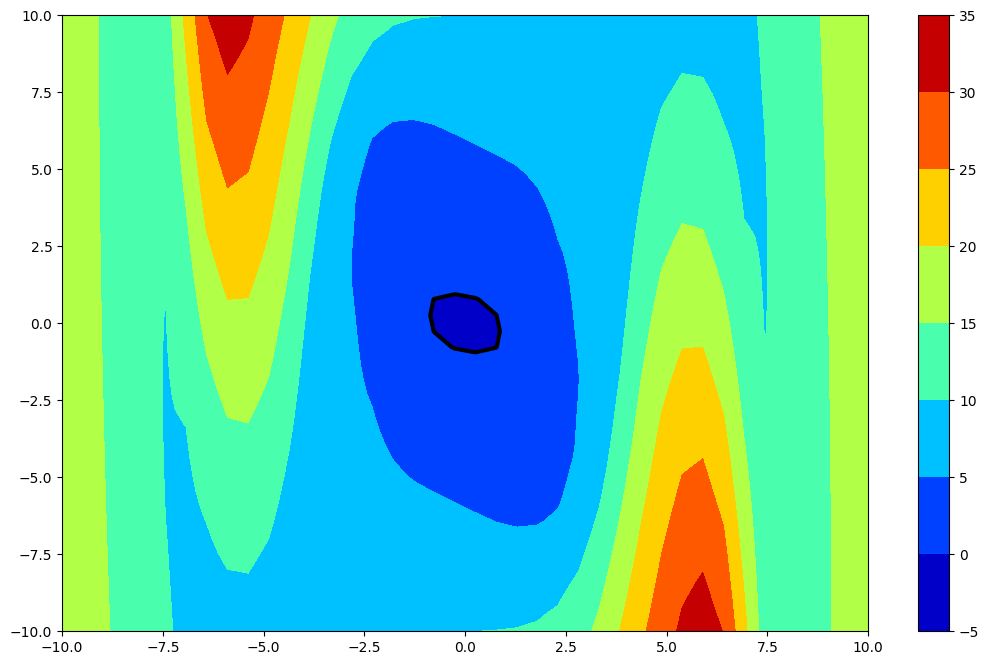

In [28]:
# print(target_values[:, :, 30].T) # --> can't be represented in 2d?
print(target_values)
print(target_values.shape)

plt.jet()
plt.figure(figsize=(13, 8))
plt.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1], target_values.T)
plt.colorbar()
plt.contour(grid.coordinate_vectors[0],
            grid.coordinate_vectors[1],
            target_values.T,
            levels=0,
            colors="black",
            linewidths=3)

In [ ]:
times = np.linspace(0, -2., 40)
# values = initial_values
print(values.shape)
all_values = hj.solve(solver_settings, dynamics, grid, times, values)
print(all_values.shape)

(40, 40)


















































































100%|##########|  2.0000/2.0 [00:00<00:00,  4.32sim_s/s]

(40, 40, 40)


In [ ]:
vmin, vmax = all_values.min(), all_values.max()
levels = np.linspace(round(vmin), round(vmax), round(vmax) - round(vmin) + 1)
fig = plt.figure(figsize=(13, 8))
print(all_values.T.shape)


def render_frame(i, colorbar=False):
    plt.contourf(grid.coordinate_vectors[0],
                 grid.coordinate_vectors[1],
                all_values[i, :, :].T,
                 vmin=vmin,
                 vmax=vmax,
                 levels=levels)
    if colorbar:
        plt.colorbar()
    plt.contour(grid.coordinate_vectors[0],
                grid.coordinate_vectors[1],
                target_values.T,
                levels=0,
                colors="black",
                linewidths=3)
    


render_frame(0, True)
animation = HTML(anim.FuncAnimation(fig, render_frame, all_values.shape[0], interval=50).to_html5_video())
plt.close(); animation

(40, 40, 40)


In [ ]:
# go.Figure(data=go.Isosurface(x=grid.states[:, :, -1, :, 0].ravel(),
#                              y=grid.states[:, :, -1, :, 1].ravel(),
#                              z=grid.states[:, :, -1, :, 3].ravel(),
#                              value=target_values[:, :, -1, :].ravel(),
#                              colorscale='jet',
#                              isomin=0,
#                              surface_count=1,
#                              isomax=0))

In [ ]:
### Defining your own dynamics: `VanderPol`

In [ ]:
class VanderPol(hj.ControlAndDisturbanceAffineDynamics):

    def __init__(self, mu=2., gamma=1., N_Nodes=1, Nodes_u=None, b_u=None, B=None, G=None, ring=False, 
                 max_position_disturbance=0.25,
                 control_mode="min",
                 disturbance_mode="max",
                 control_space=None,
                 disturbance_space=None): #pointless

        # review alpha, beta, and delta
        if control_space is None:
            control_space = hj.sets.Box(jnp.array([-mu, -gamma]), 
                                        jnp.array([mu, gamma]))
        if disturbance_space is None:
            disturbance_space = hj.sets.Ball(jnp.zeros(2), max_position_disturbance)
        
        super().__init__(control_mode, disturbance_mode, control_space, disturbance_space)

        ## This class allows the construction of networked VdP systems, but if N_nodes = 1 then we have a single system.

        self.mu, self.gamma = mu, gamma
        self.N_Nodes = N_Nodes
        if Nodes_u is None: Nodes_u = np.arange(N_Nodes)
        self.N_x, self.N_u, self.N_d = 2 * N_Nodes, len(Nodes_u), 2 * N_Nodes
        self.C = np.eye(self.N_x)

        ## If no B imported, assume one-to-one node control
        if B is None:
            self.B = np.zeros((self.N_Nodes, self.N_u))
            if b_u is None: b_u = np.ones_like(Nodes_u)

            for ui, uix in enumerate(Nodes_u):
                self.B[uix, ui] = b_u[ui]
        else:
            self.B = B

        if G is None and not(ring):
            self.G = -gamma * np.eye(N_Nodes)
        elif ring:
            self.G = -gamma * np.eye(N_Nodes) + np.diag(np.ones(N_Nodes - 1), -1) + np.diag(np.ones(N_Nodes - 1), 1) + np.diag([1], N_Nodes-1) + np.diag([1], -N_Nodes+1)
        else:
            self.G = G

    def f(self, t, x, u, d):

        xdot = np.zeros_like(x)
        xdot[::2]  = x[1::2]
        xdot[1::2] = self.mu * (1 - (x[::2] ** 2)) * x[1::2] + np.matmul(self.G, x[::2]) + np.matmul(self.B, u)
        xdot += np.matmul(self.C, d)

        return xdot
    
    def open_loop_dynamics(self, state, time):
        _, v, q = state
        return jnp.array([v * jnp.cos(q), v * jnp.sin(q), 0.])

    def control_jacobian(self, state, time):
        v = state[2]
        return jnp.array([
            # [0., 0.],
            [0., 0.],
            [1., 0.],
            [0., v],
        ])

    def disturbance_jacobian(self, state, time):
        return jnp.array([
            [1., 0.],
            [0., 1.],
            [0., 0.],
            # [0., 0.],
        ])

In [ ]:
dynamics = VanderPol()
# grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(hj.sets.Box(lo=np.array([-6., -10., -np.pi]),
#                                                                            hi=np.array([20., 10., np.pi])),
#                                                                (51, 40, 50),
#                                                                periodic_dims=2)
# values = jnp.linalg.norm(grid.states[..., :2], axis=-1) - 1

# solver_settings = hj.SolverSettings.with_accuracy("low")

grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(hj.sets.Box(np.array([-6., -10., -np.pi]),
                                                                           np.array([20., 10., np.pi])),
                                                               (51, 40, 50),
                                                               periodic_dims=2)
values = jnp.linalg.norm(grid.states[..., :2], axis=-1) - 1

solver_settings = hj.SolverSettings.with_accuracy("very_high",
                                                  hamiltonian_postprocessor=hj.solver.backwards_reachable_tube)

In [ ]:
time = 0.
target_time = -2.0
target_values = hj.step(solver_settings, dynamics, grid, time, values, target_time)

100%|##########|  2.0000/2.0 [00:02<00:00,  1.43s/sim_s]


(40, 51)


<Figure size 640x480 with 0 Axes>

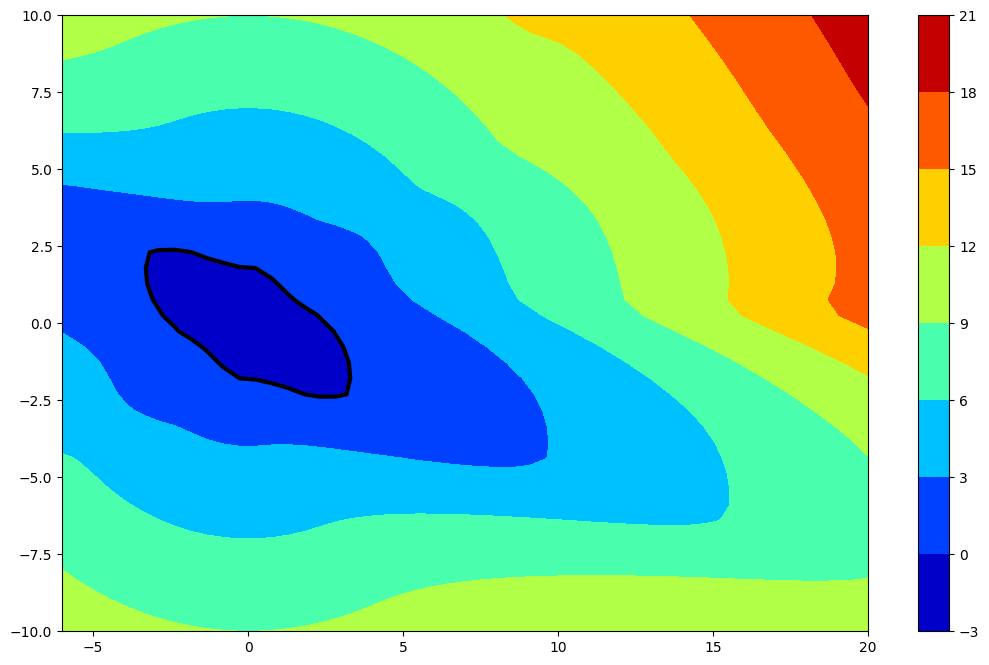

In [ ]:
print(target_values[:, :, 30].T.shape) # --> can't be represented in 2d?

plt.jet()
plt.figure(figsize=(13, 8))
plt.contourf(grid.coordinate_vectors[0], grid.coordinate_vectors[1], target_values[:, :, 30].T)
plt.colorbar()
plt.contour(grid.coordinate_vectors[0],
            grid.coordinate_vectors[1],
            target_values[:, :, 30].T,
            levels=0,
            colors="black",
            linewidths=3)

In [ ]:
times = np.linspace(0, -2.8, 57)
# values = initial_values
print(values.shape)
all_values = hj.solve(solver_settings, dynamics, grid, times, values)
print(all_values.shape)

(51, 40, 50)


100%|##########|  2.8000/2.8 [00:04<00:00,  1.65s/sim_s]

(57, 51, 40, 50)


In [ ]:
vmin, vmax = all_values.min(), all_values.max()
levels = np.linspace(round(vmin), round(vmax), round(vmax) - round(vmin) + 1)
fig = plt.figure(figsize=(13, 8))


def render_frame(i, colorbar=False):
    plt.contourf(grid.coordinate_vectors[0],
                 grid.coordinate_vectors[1],
                 all_values[i, :, :, 30].T,
                 vmin=vmin,
                 vmax=vmax,
                 levels=levels)
    if colorbar:
        plt.colorbar()
    plt.contour(grid.coordinate_vectors[0],
                grid.coordinate_vectors[1],
                target_values[:, :, 30].T,
                levels=0,
                colors="black",
                linewidths=3)
    


render_frame(0, True)
animation = HTML(anim.FuncAnimation(fig, render_frame, all_values.shape[0], interval=50).to_html5_video())
plt.close(); animation